<a href="https://colab.research.google.com/github/SahilGadge/Deep-Q-Learning-on-Ping-Pong/blob/main/DQN_Pong.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **Deep Q Learning**




# 1.   Name : Sahil Sanjay Gadge.






---



## **Abstract**



> #### **Q Learning is the reinforcement learning algorithm which uses prior experience to take future actions. In this notebook I'm using various Q learning algorithm to play atari games.**





---



## **1. Establish a baseline performance. How well did your Deep Q-learning do on your problem?**

Pong

In Pong, one player scores if the ball passes by the other player. An episode is over when one of the players reaches 21 points. In the OpenAI Gym framework version of Pong, the Agent is displayed on the right and the enemy on the left.

#### Imports and Random Player

In [ ]:
import gym 
import random

In [ ]:
import urllib.request
urllib.request.urlretrieve('http://www.atarimania.com/roms/Roms.rar','Roms.rar')
!pip install unrar
!unrar x Roms.rar
!mkdir rars
!mv HC\ ROMS.zip   rars
!mv ROMS.zip  rars
!python -m atari_py.import_roms rars


UNRAR 5.50 freeware      Copyright (c) 1993-2017 Alexander Roshal


Extracting from Roms.rar

Extracting  HC ROMS.zip                                                   36%  OK 
Extracting  ROMS.zip                                                      74% 99%  OK 
All OK
copying adventure.bin from ROMS/Adventure (1980) (Atari, Warren Robinett) (CX2613, CX2613P) (PAL).bin to /usr/local/lib/python3.7/dist-packages/atari_py/atari_roms/adventure.bin
copying air_raid.bin from ROMS/Air Raid (Men-A-Vision) (PAL) ~.bin to /usr/local/lib/python3.7/dist-packages/atari_py/atari_roms/air_raid.bin
copying alien.bin from ROMS/Alien (1982) (20th Century Fox Video Games, Douglas 'Dallas North' Neubauer) (11006) ~.bin to /usr/local/lib/python3.7/dist-packages/atari_py/atari_roms/alien.bin
copying amidar.bin from ROMS/Amidar (1982) (Parker Brothers, Ed Temple) (PB5310) ~.bin to /usr/local/lib/python3.7/dist-packages/atari_py/atari_roms/amidar.bin
copying assault.bin from ROMS/Assau

There are three actions an Agent (player) can take within the Pong Environment: remaining stationary, vertical translation up, and vertical translation down. However, if we use the method action_space.n we can realize that the Environment has 6 actions.

In [ ]:
import gym
import gym.spaces

DEFAULT_ENV_NAME = "PongNoFrameskip-v4" 
test_env = gym.make(DEFAULT_ENV_NAME)
print(test_env.action_space.n)

6


Three of the six being redundant (FIRE is equal to NOOP, LEFT is equal to LEFTFIRE and RIGHT is equal to RIGHTFIRE).

In [ ]:
print(test_env.unwrapped.get_action_meanings())

['NOOP', 'FIRE', 'RIGHT', 'LEFT', 'RIGHTFIRE', 'LEFTFIRE']


Atari games are displayed at a resolution of 210 by 160 pixels, with 128 possible colors for each pixel.

In [ ]:
print(test_env.observation_space.shape)

(210, 160, 3)


This is still technically a discrete state space but very large to process as it is and we can optimize it. To reduce this complexity, it is performed some minimal processing: convert the frames to grayscale, and scale them down to a square 84 by 84 pixel block. 

Performance when we take random actions

In [ ]:
episodes = 10
for episode in range(1, episodes+1):
    state = test_env.reset()
    done = False
    score = 0 
    
    while not done:
        #test_env.render()
        action = random.choice([0,1,2,3,4,5])
        n_state, reward, done, info = test_env.step(action)
        score+=reward
    print('Episode:{} Score:{}'.format(episode, score))
test_env.close()

Episode:1 Score:-21.0
Episode:2 Score:-21.0
Episode:3 Score:-21.0
Episode:4 Score:-19.0
Episode:5 Score:-21.0
Episode:6 Score:-17.0
Episode:7 Score:-21.0
Episode:8 Score:-19.0
Episode:9 Score:-19.0
Episode:10 Score:-20.0



> **In this game -21 is worst score and 21 is the best score**






In [ ]:
#Ignore warnings 
import warnings
warnings.filterwarnings('ignore')

#### OpenAI Gym Wrappers

Pong require a user to press the FIRE button to start the game. The following code corresponds to the wrapper FireResetEnvthat presses the FIRE button in environments that require that for the game to start. In addition to pressing FIRE, this wrapper checks for several corner cases that are present in some games.

In [ ]:
# Taken from 
# https://github.com/PacktPublishing/Deep-Reinforcement-Learning-Hands-On/blob/master/Chapter06/lib/wrappers.py

import cv2
import numpy as np
import collections

class FireResetEnv(gym.Wrapper):
    def __init__(self, env=None):
        super(FireResetEnv, self).__init__(env)
        assert env.unwrapped.get_action_meanings()[1] == 'FIRE'
        assert len(env.unwrapped.get_action_meanings()) >= 3

    def step(self, action):
        return self.env.step(action)

    def reset(self):
        self.env.reset()
        obs, _, done, _ = self.env.step(1)
        if done:
            self.env.reset()
        obs, _, done, _ = self.env.step(2)
        if done:
            self.env.reset()
        return obs

The next wrapper that we will require is MaxAndSkipEnv that codes a couple of important transformations for Pong:


> On one hand, it allows us to speed up significantly the training by applying max to N observations (four by default) and returns this as an observation for the step. This is because on intermediate frames, the chosen action is simply repeated and we can make an action decision every N steps as processing every frame with a Neural Network is quite a demanding operation, but the difference between consequent frames is usually minor.


> On the other hand, it takes the maximum of every pixel in the last two frames and using it as an observation. Some Atari games have a flickering effect (when the game draws different portions of the screen on even and odd frames, a normal practice among Atari 2600 developers to increase the complexity of the game’s sprites), which is due to the platform’s limitation. For the human eye, such quick changes are not visible, but they can confuse a Neural Network.







In [ ]:
# Taken from 
# https://github.com/PacktPublishing/Deep-Reinforcement-Learning-Hands-On/blob/master/Chapter06/lib/wrappers.py

class MaxAndSkipEnv(gym.Wrapper):
    def __init__(self, env=None, skip=4):
        super(MaxAndSkipEnv, self).__init__(env)
        # most recent raw observations (for max pooling across time steps)
        self._obs_buffer = collections.deque(maxlen=2)
        self._skip = skip

    def step(self, action):
        total_reward = 0.0
        done = None
        for _ in range(self._skip):
            obs, reward, done, info = self.env.step(action)
            self._obs_buffer.append(obs)
            total_reward += reward
            if done:
                break
        max_frame = np.max(np.stack(self._obs_buffer), axis=0)
        return max_frame, total_reward, done, info

    def reset(self):
        self._obs_buffer.clear()
        obs = self.env.reset()
        self._obs_buffer.append(obs)
        return obs

Solution to the lack of game dynamics in a single game frame, the class BufferWrapper stacks several (usually four) subsequent frames together.

In [ ]:
class BufferWrapper(gym.ObservationWrapper):
    def __init__(self, env, n_steps, dtype=np.float32):
        super(BufferWrapper, self).__init__(env)
        self.dtype = dtype
        old_space = env.observation_space
        self.observation_space = gym.spaces.Box(old_space.low.repeat(n_steps, axis=0),
                                                old_space.high.repeat(n_steps, axis=0), dtype=dtype)

    def reset(self):
        self.buffer = np.zeros_like(self.observation_space.low, dtype=self.dtype)
        return self.observation(self.env.reset())

    def observation(self, observation):
        self.buffer[:-1] = self.buffer[1:]
        self.buffer[-1] = observation
        return self.buffer

To reduce complexity, it is performed some minimal processing: convert the frames to grayscale, and scale them down to a square 84 by 84 pixel block.

In [ ]:
class ProcessFrame84(gym.ObservationWrapper):
    def __init__(self, env=None):
        super(ProcessFrame84, self).__init__(env)
        self.observation_space = gym.spaces.Box(low=0, high=255, shape=(84, 84, 1), dtype=np.uint8)

    def observation(self, obs):
        return ProcessFrame84.process(obs)

    @staticmethod
    def process(frame):
        if frame.size == 210 * 160 * 3:
            img = np.reshape(frame, [210, 160, 3]).astype(np.float32)
        elif frame.size == 250 * 160 * 3:
            img = np.reshape(frame, [250, 160, 3]).astype(np.float32)
        else:
            assert False, "Unknown resolution."
        img = img[:, :, 0] * 0.299 + img[:, :, 1] * 0.587 + img[:, :, 2] * 0.114
        resized_screen = cv2.resize(img, (84, 110), interpolation=cv2.INTER_AREA)
        x_t = resized_screen[18:102, :]
        x_t = np.reshape(x_t, [84, 84, 1])
        return x_t.astype(np.uint8)

The input shape of the tensor has a color channel as the last dimension, but PyTorch’s convolution layers assume the color channel to be the first dimension. This simple wrapper changes the shape of the observation from HWC (height, width, channel) to the CHW (channel, height, width) format required by PyTorch.

In [ ]:

class ImageToPyTorch(gym.ObservationWrapper):
    def __init__(self, env):
        super(ImageToPyTorch, self).__init__(env)
        old_shape = self.observation_space.shape
        self.observation_space = gym.spaces.Box(low=0.0, high=1.0, shape=(old_shape[-1], 
                                old_shape[0], old_shape[1]), dtype=np.float32)

    def observation(self, observation):
        return np.moveaxis(observation, 2, 0)





The screen obtained from the emulator is encoded as a tensor of bytes with values from 0 to 255, which is not the best representation for an NN. So, we need to convert the image into floats and rescale the values to the range [0.0…1.0]. This is done by the ScaledFloatFrame wrapper

In [ ]:
class ScaledFloatFrame(gym.ObservationWrapper):
    def observation(self, obs):
        return np.array(obs).astype(np.float32) / 255.0

Finally, it will be helpful for the following simple function make_env that creates an environment by its name and applies all the required wrappers to it:

In [ ]:
def make_env(env_name):
    env = gym.make(env_name)
    env = MaxAndSkipEnv(env)
    env = FireResetEnv(env)
    env = ProcessFrame84(env)
    env = ImageToPyTorch(env)
    env = BufferWrapper(env, 4)
    return ScaledFloatFrame(env)

#### The DQN model


In [ ]:
import torch
import torch.nn as nn        # Pytorch neural network package
import torch.optim as optim  # Pytorch optimization package

device = torch.device("cpu")

The screen images are first processed by three convolutional layers. This allows the system to exploit spatial relationships, and can sploit spatial rule space. Also, since four frames are stacked and provided as input, these convolutional layers also extract some temporal properties across those frames. Using PyTorch, we can code the convolutional part of the model as follows.

In [ ]:
# Taken from 
# https://github.com/PacktPublishing/Deep-Reinforcement-Learning-Hands-On/blob/master/Chapter06/lib/dqn_model.py

import numpy as np

class DQN(nn.Module):
    def __init__(self, input_shape, n_actions):
        super(DQN, self).__init__()
        #input_shape is the observation_space.shape of the Environment
        self.conv = nn.Sequential(
            nn.Conv2d(input_shape[0], 32, kernel_size=8, stride=4),
            nn.ReLU(),
            nn.Conv2d(32, 64, kernel_size=4, stride=2),
            nn.ReLU(),
            nn.Conv2d(64, 64, kernel_size=3, stride=1),
            nn.ReLU()
        )
        """conv_out_size is the number of values in the output from the convolution layer produced with the input of the given shape
        This value is needed to pass to the first fully connected layer constructor and can be hard-coded due it is a function of the input 
        shape (for 84x84 input, the output from the convolution layer will have 3136). However, in order to code 
        a generic model (for all the games) that can accept different input shape, we will use a simple function, 
        _get_conv_out that accepts the input shape and applies the convolution layer to a fake tensor of such a shape"""
        conv_out_size = self._get_conv_out(input_shape)
        self.fc = nn.Sequential(
            nn.Linear(conv_out_size, 512),
            nn.ReLU(),
            nn.Linear(512, n_actions)
        )

    def _get_conv_out(self, shape):
        o = self.conv(torch.zeros(1, *shape))
        return int(np.prod(o.size()))

    def forward(self, x):
        conv_out = self.conv(x).view(x.size()[0], -1)
        return self.fc(conv_out)

In [ ]:
test_env = make_env(DEFAULT_ENV_NAME)
test_net = DQN(test_env.observation_space.shape, test_env.action_space.n).to(device)
print(test_net)

DQN(
  (conv): Sequential(
    (0): Conv2d(4, 32, kernel_size=(8, 8), stride=(4, 4))
    (1): ReLU()
    (2): Conv2d(32, 64, kernel_size=(4, 4), stride=(2, 2))
    (3): ReLU()
    (4): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1))
    (5): ReLU()
  )
  (fc): Sequential(
    (0): Linear(in_features=3136, out_features=512, bias=True)
    (1): ReLU()
    (2): Linear(in_features=512, out_features=6, bias=True)
  )
)


#### Training

Load Tensorboard extension

In [ ]:
from torch.utils.tensorboard import SummaryWriter
%load_ext tensorboard

Import required modules and define the hyperparameters









*   gamma is the discount factor
*   batch_size, the minibatch size


*   learning_rateis the learning rate
*   replay_sizethe replay buffer size (maximum number of experiences stored in replay memory)


*   sync_target_framesindicates how frequently we sync model weights from the main DQN network to the target DQN network (how many frames in between syncing)
*   replay_start_size the count of frames (experiences) to add to replay buffer before starting training.








In [ ]:
import time
import numpy as np
import collections


MEAN_REWARD_BOUND = 19.0           

gamma = 0.99                   
batch_size = 32                
replay_size = 10000            
learning_rate = 1e-4     #alpha    
sync_target_frames = 1000      
replay_start_size = 10000      

eps_start=1.0
eps_decay=.999985
eps_min=0.02

Experience replay buffer

The basic idea behind experience replay is to storing past experiences and then using a random subset of these experiences to update the Q-network, rather than using just the single most recent experience. In order to store the Agent’s experiences, we used a data structure called a deque in Python’s built-in collections library. It’s basically a list that you can set a maximum size on so that if you try to append to the list and it is already full, it will remove the first item in the list and add the new item to the end of the list. The experiences themselves are tuples of [observation, action, reward, done flag, next state] to keep the transitions obtained from the environment.

Each time the Agent does a step in the Environment, it pushes the transition into the buffer, keeping only a fixed number of steps (in our case, 10k transitions). For training, we randomly sample the batch of transitions from the replay buffer, which allows us to break the correlation between subsequent steps in the environment.
Most of the experience replay buffer code is quite straightforward: it basically exploits the capability of the deque library. In the sample() method, we create a list of random indices and then repack the sampled entries into NumPy arrays for more convenient loss calculation.

In [ ]:
Experience = collections.namedtuple('Experience', field_names=['state', 'action', 'reward', 'done', 'new_state'])

class ExperienceReplay:
    def __init__(self, capacity):
        self.buffer = collections.deque(maxlen=capacity)

    def __len__(self):
        return len(self.buffer)

    def append(self, experience):
        self.buffer.append(experience)

    def sample(self, batch_size):
        indices = np.random.choice(len(self.buffer), batch_size, replace=False)
        states, actions, rewards, dones, next_states = zip(*[self.buffer[idx] for idx in indices])
        return np.array(states), np.array(actions), np.array(rewards, dtype=np.float32), \
               np.array(dones, dtype=np.uint8), np.array(next_states)


Agent-
At the heart of the Agent of this new approach, we found a deep neural network instead of a Q-table as we saw in the previous post. It should be noted that the Agent was only given raw pixel data, what a human player would see on screen


Agent interacts with the Environment, and saves the result of the interaction into the experience replay buffer.

In [ ]:
class Agent:
    def __init__(self, env, exp_buffer):
        self.env = env
        self.exp_buffer = exp_buffer
        self._reset()

    def _reset(self):
        self.state = env.reset()
        self.total_reward = 0.0
        
    """ The method play_step uses an ϵ-greedy(Q) policy to select actions at every time step. In other words, with the probability 
    epsilon (passed as an argument), we take the random action; otherwise, we use the past model to obtain the Q-values for all possible 
    actions and choose the best. After obtaining the action the method performs the step in the Environment to get the next 
    observation: next_state, reward and is_done"""
    def play_step(self, net, epsilon=0.0, device="cpu"):

        done_reward = None
        if np.random.random() < epsilon:
            action = env.action_space.sample()
        else:
            state_a = np.array([self.state], copy=False)
            state_v = torch.tensor(state_a).to(device)
            q_vals_v = net(state_v)
            _, act_v = torch.max(q_vals_v, dim=1)
            action = int(act_v.item())

        new_state, reward, is_done, _ = self.env.step(action)
        self.total_reward += reward

        exp = Experience(self.state, action, reward, is_done, new_state)
        self.exp_buffer.append(exp)
        self.state = new_state
        if is_done:
            done_reward = self.total_reward
            self._reset()
        return done_reward


In [ ]:
import datetime
print(">>>Training starts at ",datetime.datetime.now())

>>>Training starts at  2022-02-23 22:49:10.662009


In the initialization part, we create our environment with all required wrappers applied, the main DQN neural network that we are going to train, and our target network with the same architecture. We also create the experience replay buffer of the required size and pass it to the agent. The last things we do before the training loop are to create an optimizer, a buffer for full episode rewards, a counter of frames and a variable to track the best mean reward reached (because every time the mean reward beats the record, we will save the model in a file)

In [ ]:
env = make_env(DEFAULT_ENV_NAME)

net = DQN(env.observation_space.shape, env.action_space.n).to(device)
target_net = DQN(env.observation_space.shape, env.action_space.n).to(device)
writer = SummaryWriter(comment="-" + DEFAULT_ENV_NAME)
 
buffer = ExperienceReplay(replay_size)
agent = Agent(env, buffer)

epsilon = eps_start

optimizer = optim.Adam(net.parameters(), lr=learning_rate)
total_rewards = []
frame_idx = 0  

best_mean_reward = None

while True:
        frame_idx += 1
        epsilon = max(epsilon*eps_decay, eps_min)

        reward = agent.play_step(net, epsilon, device=device)
        if reward is not None:
            total_rewards.append(reward)

            mean_reward = np.mean(total_rewards[-100:])

            print("%d:  %d games, mean reward %.3f, (epsilon %.2f)" % (
                frame_idx, len(total_rewards), mean_reward, epsilon))
            
            writer.add_scalar("epsilon", epsilon, frame_idx)
            writer.add_scalar("reward_100", mean_reward, frame_idx)
            writer.add_scalar("reward", reward, frame_idx)

            if best_mean_reward is None or best_mean_reward < mean_reward:
                torch.save(net.state_dict(), DEFAULT_ENV_NAME + "-bestdqn.dat")
                best_mean_reward = mean_reward
                if best_mean_reward is not None:
                    print("Best mean reward updated %.3f" % (best_mean_reward))

            if mean_reward > MEAN_REWARD_BOUND:
                print("Solved in %d frames!" % frame_idx)
                break

        if len(buffer) < replay_start_size:
            continue

        batch = buffer.sample(batch_size)
        states, actions, rewards, dones, next_states = batch

        states_v = torch.tensor(states).to(device)
        next_states_v = torch.tensor(next_states).to(device)
        actions_v = torch.tensor(actions).to(device)
        rewards_v = torch.tensor(rewards).to(device)
        done_mask = torch.ByteTensor(dones).to(device)

        state_action_values = net(states_v).gather(1, actions_v.unsqueeze(-1)).squeeze(-1)

        next_state_values = target_net(next_states_v).max(1)[0]

        next_state_values[done_mask] = 0.0

        next_state_values = next_state_values.detach()

        expected_state_action_values = next_state_values * gamma + rewards_v

        loss_t = nn.MSELoss()(state_action_values, expected_state_action_values)

        optimizer.zero_grad()
        loss_t.backward()
        optimizer.step()

        if frame_idx % sync_target_frames == 0:
            target_net.load_state_dict(net.state_dict())
       
writer.close()

1079:  1 games, mean reward -20.000, (epsilon 0.98)
Best mean reward updated -20.000
2052:  2 games, mean reward -20.500, (epsilon 0.97)
2906:  3 games, mean reward -20.667, (epsilon 0.96)
3809:  4 games, mean reward -20.750, (epsilon 0.94)
4709:  5 games, mean reward -20.600, (epsilon 0.93)
5527:  6 games, mean reward -20.667, (epsilon 0.92)
6364:  7 games, mean reward -20.714, (epsilon 0.91)
7201:  8 games, mean reward -20.750, (epsilon 0.90)
8053:  9 games, mean reward -20.778, (epsilon 0.89)
8931:  10 games, mean reward -20.800, (epsilon 0.87)
9800:  11 games, mean reward -20.727, (epsilon 0.86)
10581:  12 games, mean reward -20.750, (epsilon 0.85)
11444:  13 games, mean reward -20.692, (epsilon 0.84)
12272:  14 games, mean reward -20.714, (epsilon 0.83)
13313:  15 games, mean reward -20.667, (epsilon 0.82)
14094:  16 games, mean reward -20.688, (epsilon 0.81)
14856:  17 games, mean reward -20.706, (epsilon 0.80)
15678:  18 games, mean reward -20.722, (epsilon 0.79)
16500:  19 game

Performance

In [51]:
tensorboard  --logdir=runs

Reusing TensorBoard on port 6006 (pid 408), started 0:08:07 ago. (Use '!kill 408' to kill it.)

<IPython.core.display.Javascript object>

#### Using the model

In [ ]:
import gym
import time
import numpy as np

import torch

import collections

DEFAULT_ENV_NAME = "PongNoFrameskip-v4"
FPS = 25

Tunning the image rendering in colab


In [ ]:
# Taken from 
# https://towardsdatascience.com/rendering-openai-gym-envs-on-binder-and-google-colab-536f99391cc7

!apt-get install -y xvfb x11-utils

!pip install pyvirtualdisplay==0.2.* \
             PyOpenGL==3.1.* \
             PyOpenGL-accelerate==3.1.*

!pip install gym[box2d]==0.17.*

import pyvirtualdisplay

_display = pyvirtualdisplay.Display(visible=False, size=(1400, 900))
_ = _display.start()

Reading package lists... Done
Building dependency tree       
Reading state information... Done
The following package was automatically installed and is no longer required:
  libnvidia-common-470
Use 'apt autoremove' to remove it.
The following additional packages will be installed:
  libxxf86dga1
Suggested packages:
  mesa-utils
The following NEW packages will be installed:
  libxxf86dga1 x11-utils xvfb
0 upgraded, 3 newly installed, 0 to remove and 39 not upgraded.
Need to get 993 kB of archives.
After this operation, 2,982 kB of additional disk space will be used.
Get:1 http://archive.ubuntu.com/ubuntu bionic/main amd64 libxxf86dga1 amd64 2:1.1.4-1 [13.7 kB]
Get:2 http://archive.ubuntu.com/ubuntu bionic/main amd64 x11-utils amd64 7.7+3build1 [196 kB]
Get:3 http://archive.ubuntu.com/ubuntu bionic-updates/universe amd64 xvfb amd64 2:1.19.6-1ubuntu4.10 [784 kB]
Fetched 993 kB in 1s (1,055 kB/s)
Selecting previously unselected package libxxf86dga1:amd64.
(Reading database ... 155320 fil

This is code to save env.render() as a video. You can view output video on following link.

https://www.youtube.com/watch?v=P2JnptARwvQ

In [ ]:
# Taken (partially) from 
# https://github.com/PacktPublishing/Deep-Reinforcement-Learning-Hands-On/blob/master/Chapter06/03_dqn_play.py


model='PongNoFrameskip-v4-bestdqn-best.dat'
record_folder="video"  
visualize=True

env = make_env(DEFAULT_ENV_NAME)
if record_folder:
        env = gym.wrappers.Monitor(env, record_folder, force=True)
net = DQN(env.observation_space.shape, env.action_space.n)
net.load_state_dict(torch.load(model, map_location=lambda storage, loc: storage))

state = env.reset()
total_reward = 0.0

while True:
        start_ts = time.time()
        if visualize:
            env.render()
        state_v = torch.tensor(np.array([state], copy=False))
        q_vals = net(state_v).data.numpy()[0]
        action = np.argmax(q_vals)
        
        state, reward, done, _ = env.step(action)
        total_reward += reward
        if done:
            break
        if visualize:
            delta = 1/FPS - (time.time() - start_ts)
            if delta > 0:
                time.sleep(delta)
print("Total reward: %.2f" % total_reward)

if record_folder:
        env.close()

##**2. What are the states, the actions, and the size of the Q-table?**



> **Actions**



There are three actions an Agent (player) can take within the Pong Environment: remaining stationary, vertical translation up, and vertical translation down. However, if we use the method action_space.n we can realize that the Environment has 6 actions.

In [ ]:
import gym
import gym.spaces

DEFAULT_ENV_NAME = "PongNoFrameskip-v4" 
env = gym.make(DEFAULT_ENV_NAME)
print(env.action_space.n)

6


In [ ]:
print(env.unwrapped.get_action_meanings())

['NOOP', 'FIRE', 'RIGHT', 'LEFT', 'RIGHTFIRE', 'LEFTFIRE']


Three of the six being redundant (FIRE is equal to NOOP, LEFT is equal to LEFTFIRE and RIGHT is equal to RIGHTFIRE).



> **States**



Actual States 

In [ ]:
env.observation_space.shape

(210, 160, 3)

After Processing Environment

In [ ]:
env.observation_space.shape

(4, 84, 84)

We are dealing with the ping pong environmnet in which ball call be at any position in 84*84 grid and also there are 84 positions each for cpu and agents brick to move 

Therefore




In [ ]:
states = 84*84*4
states

28224



> **Q-Table Size**



In [ ]:
q = states*(env.action_space.n) #states*actions
q

169344

##**3. What are the rewards? Why did you choose them?**

In Pong, one player scores if the ball passes by the other player. An episode is over when one of the players reaches 21 points.



> **Rewards**





In this model we reward one point to agent when it defeats cpu ones.

When cpu defets our agent we will -1 point from agent.

By this logic

1. If CPU defeats our agent every time then our agent will have -21 points. Where our training start.

2. If Our agent defeats CPU everytime then agent will have +21 points. This is where training should end. But because of the computation issue we end it on +19 mean points.

3. In between case- If CPU defets agent 10 times. And agent wins with the 21 points. We will reward aur agent with 11 points (21-10).



> Why These Rewards?


This rewards not only focus on agent win the game. But also focus on not losing few points while playing. 




##**4. How did you choose alpha and gamma in the Bellman equation? Try at least one additional value for alpha and gamma. How did it change the baseline performance?**



> Gamma is the value of future reward.


A gamma of zero will cause the agent to only value immediate rewards.

Gammas should correspond to the size of observation space: you should use larger gammas (ie closer to 1) for big state spaces, and smaller gammas for smaller spaces.


In our case observation space in higher so I chose **gamma = 0.99**



> Alpha is the learning rate.

It is the learning rate, set generally between 0 and 1. Setting the alpha value to 0 means that the Q-values are never updated, thereby nothing is learned. If we set the alpha to a high value such as 0.9, it means that the learning can occur quickly.


In our case observation space is big so I set **alpha = 0.0001**

I tried **gamma = 0.89** and **aplpha = 0.1**

In [ ]:
import time
import numpy as np
import collections


MEAN_REWARD_BOUND = 19.0           

gamma = 0.89                   
batch_size = 32                
replay_size = 10000            
learning_rate = 0.1           
sync_target_frames = 1000      
replay_start_size = 10000      

eps_start=1.0
eps_decay=.999985
eps_min=0.01

Conclusion was agent had difficulty in learning and it was stuck at -20.640 reward. So I inturupted the execution. Agent might have taken twice time to learn than orignal parameters.

In [ ]:
env = make_env(DEFAULT_ENV_NAME)

net = DQN(env.observation_space.shape, env.action_space.n).to(device)
target_net = DQN(env.observation_space.shape, env.action_space.n).to(device)
writer = SummaryWriter(comment="-" + DEFAULT_ENV_NAME)
 
buffer = ExperienceReplay(replay_size)
agent = Agent(env, buffer)

epsilon = eps_start

optimizer = optim.Adam(net.parameters(), lr=learning_rate)
total_rewards = []
frame_idx = 0  

best_mean_reward = None

while True:
        frame_idx += 1
        epsilon = max(epsilon*eps_decay, eps_min)

        reward = agent.play_step(net, epsilon, device=device)
        if reward is not None:
            total_rewards.append(reward)

            mean_reward = np.mean(total_rewards[-100:])

            print("%d:  %d games, mean reward %.3f, (epsilon %.2f)" % (
                frame_idx, len(total_rewards), mean_reward, epsilon))
            
            writer.add_scalar("epsilon", epsilon, frame_idx)
            writer.add_scalar("reward_100", mean_reward, frame_idx)
            writer.add_scalar("reward", reward, frame_idx)

            if best_mean_reward is None or best_mean_reward < mean_reward:
                torch.save(net.state_dict(), DEFAULT_ENV_NAME + "-bestdqn.dat")
                best_mean_reward = mean_reward
                if best_mean_reward is not None:
                    print("Best mean reward updated %.3f" % (best_mean_reward))

            if mean_reward > MEAN_REWARD_BOUND:
                print("Solved in %d frames!" % frame_idx)
                break

        if len(buffer) < replay_start_size:
            continue

        batch = buffer.sample(batch_size)
        states, actions, rewards, dones, next_states = batch

        states_v = torch.tensor(states).to(device)
        next_states_v = torch.tensor(next_states).to(device)
        actions_v = torch.tensor(actions).to(device)
        rewards_v = torch.tensor(rewards).to(device)
        done_mask = torch.ByteTensor(dones).to(device)

        state_action_values = net(states_v).gather(1, actions_v.unsqueeze(-1)).squeeze(-1)

        next_state_values = target_net(next_states_v).max(1)[0]

        next_state_values[done_mask] = 0.0

        next_state_values = next_state_values.detach()

        expected_state_action_values = next_state_values * gamma + rewards_v

        loss_t = nn.MSELoss()(state_action_values, expected_state_action_values)

        optimizer.zero_grad()
        loss_t.backward()
        optimizer.step()

        if frame_idx % sync_target_frames == 0:
            target_net.load_state_dict(net.state_dict())
       
writer.close()

945:  1 games, mean reward -21.000, (epsilon 0.99)
Best mean reward updated -21.000
1707:  2 games, mean reward -21.000, (epsilon 0.97)
2631:  3 games, mean reward -20.667, (epsilon 0.96)
Best mean reward updated -20.667
3449:  4 games, mean reward -20.750, (epsilon 0.95)
4438:  5 games, mean reward -20.400, (epsilon 0.94)
Best mean reward updated -20.400
5485:  6 games, mean reward -20.500, (epsilon 0.92)
6247:  7 games, mean reward -20.571, (epsilon 0.91)
7157:  8 games, mean reward -20.625, (epsilon 0.90)
8150:  9 games, mean reward -20.556, (epsilon 0.88)
9000:  10 games, mean reward -20.600, (epsilon 0.87)
9886:  11 games, mean reward -20.636, (epsilon 0.86)
10787:  12 games, mean reward -20.667, (epsilon 0.85)
11919:  13 games, mean reward -20.692, (epsilon 0.84)
12772:  14 games, mean reward -20.714, (epsilon 0.83)
13652:  15 games, mean reward -20.733, (epsilon 0.81)
14622:  16 games, mean reward -20.750, (epsilon 0.80)
15474:  17 games, mean reward -20.765, (epsilon 0.79)
1648

KeyboardInterrupt: 


##**5. Try a policy other than e-greedy. How did it change the baseline performance?**

####Exploit Only Policy with Q- Learning

In [ ]:
class Agent:
    def __init__(self, env, exp_buffer):
        self.env = env
        self.exp_buffer = exp_buffer
        self._reset()

    def _reset(self):
        self.state = env.reset()
        self.total_reward = 0.0

    def play_step(self, net, epsilon=0.0, device="cuda"):

        done_reward = None
        state_a = np.array([self.state], copy=False)
        state_v = torch.tensor(state_a).to(device)
        q_vals_v = net(state_v)
        _, act_v = torch.max(q_vals_v, dim=1) #Exploit only select max rewarded action only
        action = int(act_v.item())

        new_state, reward, is_done, _ = self.env.step(action)
        self.total_reward += reward

        exp = Experience(self.state, action, reward, is_done, new_state)
        self.exp_buffer.append(exp)
        self.state = new_state
        if is_done:
            done_reward = self.total_reward
            self._reset()
        return done_reward


In [ ]:
env = make_env(DEFAULT_ENV_NAME)

net = DQN(env.observation_space.shape, env.action_space.n).to(device)
target_net = DQN(env.observation_space.shape, env.action_space.n).to(device)
writer = SummaryWriter(comment="-" + DEFAULT_ENV_NAME)
 
buffer = ExperienceReplay(replay_size)
agent = Agent(env, buffer)

epsilon = eps_start

optimizer = optim.Adam(net.parameters(), lr=learning_rate)
total_rewards = []
frame_idx = 0  

best_mean_reward = None

while True:
        frame_idx += 1
        epsilon = max(epsilon*eps_decay, eps_min)

        reward = agent.play_step(net, epsilon, device=device)
        if reward is not None:
            total_rewards.append(reward)

            mean_reward = np.mean(total_rewards[-100:])

            print("%d:  %d games, mean reward %.3f" % (
                frame_idx, len(total_rewards), mean_reward))
            
            writer.add_scalar("epsilon", epsilon, frame_idx)
            writer.add_scalar("reward_100", mean_reward, frame_idx)
            writer.add_scalar("reward", reward, frame_idx)

            if best_mean_reward is None or best_mean_reward < mean_reward:
                torch.save(net.state_dict(), DEFAULT_ENV_NAME + "-bestdqn.dat")
                best_mean_reward = mean_reward
                if best_mean_reward is not None:
                    print("Best mean reward updated %.3f" % (best_mean_reward))

            if mean_reward > MEAN_REWARD_BOUND:
                print("Solved in %d frames!" % frame_idx)
                break

        if len(buffer) < replay_start_size:
            continue

        batch = buffer.sample(batch_size)
        states, actions, rewards, dones, next_states = batch

        states_v = torch.tensor(states).to(device)
        next_states_v = torch.tensor(next_states).to(device)
        actions_v = torch.tensor(actions).to(device)
        rewards_v = torch.tensor(rewards).to(device)
        done_mask = torch.ByteTensor(dones).to(device)

        state_action_values = net(states_v).gather(1, actions_v.unsqueeze(-1)).squeeze(-1)

        next_state_values = target_net(next_states_v).max(1)[0]

        next_state_values[done_mask] = 0.0

        next_state_values = next_state_values.detach()

        expected_state_action_values = next_state_values * gamma + rewards_v

        loss_t = nn.MSELoss()(state_action_values, expected_state_action_values)

        optimizer.zero_grad()
        loss_t.backward()
        optimizer.step()

        if frame_idx % sync_target_frames == 0:
            target_net.load_state_dict(net.state_dict())
       
writer.close()

762:  1 games, mean reward -21.000
Best mean reward updated -21.000
1524:  2 games, mean reward -21.000
2286:  3 games, mean reward -21.000
3048:  4 games, mean reward -21.000
3810:  5 games, mean reward -21.000
4572:  6 games, mean reward -21.000
5334:  7 games, mean reward -21.000
6096:  8 games, mean reward -21.000
6858:  9 games, mean reward -21.000
7620:  10 games, mean reward -21.000
8382:  11 games, mean reward -21.000
9144:  12 games, mean reward -21.000
9906:  13 games, mean reward -21.000
10668:  14 games, mean reward -21.000
11430:  15 games, mean reward -21.000
12192:  16 games, mean reward -21.000
12954:  17 games, mean reward -21.000
13716:  18 games, mean reward -21.000
14478:  19 games, mean reward -21.000
15240:  20 games, mean reward -21.000
16002:  21 games, mean reward -21.000
16764:  22 games, mean reward -21.000
17526:  23 games, mean reward -21.000
18288:  24 games, mean reward -21.000
19050:  25 games, mean reward -21.000
19812:  26 games, mean reward -21.000
20

Explore only selects actions with max rewards. In the begining it struggles and as model progess it shows some improvement. However after few games reward just stops increasing. This might be because lack of exploring better options.

####UCB Policy with Q- Learning

In [ ]:
class Agent:
    def __init__(self, env, exp_buffer):
        self.env = env
        self.exp_buffer = exp_buffer
        self._reset()

    def _reset(self):
        self.state = env.reset()
        self.total_reward = 0.0

    def play_step(self, net, frame,selected,epsilon=0.0,device="cuda"):
        
        
        done_reward = None
        
        state_a = np.array([self.state], copy=False)
        state_v = torch.tensor(state_a).to(device)
        q_vals_v = net(state_v)
        #q, act_v = torch.max(q_vals_v, dim=1)
        #action = int(act_v.item())
        l = (q_vals_v.tolist())[0]
        #calculating value UCB
        mu_plus_ucb = [l[idx] + np.sqrt(2*np.log(frame) / l[idx]) for idx in range(5)]
        #print(np.argmax(mu_plus_ucb),' ', action)
            
        new_state, reward, is_done, _ = self.env.step(np.argmax(mu_plus_ucb)) #Selecting max UCB
        self.total_reward += reward

        exp = Experience(self.state, action, reward, is_done, new_state)
        self.exp_buffer.append(exp)
        self.state = new_state
        if is_done:
            done_reward = self.total_reward
            self._reset()
        return done_reward,action


In [ ]:
env = make_env(DEFAULT_ENV_NAME)

net = DQN(env.observation_space.shape, env.action_space.n).to(device)
target_net = DQN(env.observation_space.shape, env.action_space.n).to(device)
writer = SummaryWriter(comment="-" + DEFAULT_ENV_NAME)

buffer = ExperienceReplay(replay_size)
agent = Agent(env, buffer)

epsilon = eps_start

optimizer = optim.Adam(net.parameters(), lr=learning_rate)
total_rewards = []
frame_idx = 0  
selected = [0,0,0,0,0,0]
best_mean_reward = None

while True:
        frame_idx += 1
        epsilon = max(epsilon*eps_decay, eps_min)
        
        reward,action = agent.play_step(net,frame_idx,selected, epsilon, device=device)
        selected[action] = selected[action] + 1
        if reward is not None:
            total_rewards.append(reward)
            
            mean_reward = np.mean(total_rewards[-100:])

            print("%d:  %d games, mean reward %.3f" % (
                frame_idx, len(total_rewards), mean_reward))
            
            writer.add_scalar("epsilon", epsilon, frame_idx)
            writer.add_scalar("reward_100", mean_reward, frame_idx)
            writer.add_scalar("reward", reward, frame_idx)

            if best_mean_reward is None or best_mean_reward < mean_reward:
                torch.save(net.state_dict(), DEFAULT_ENV_NAME + "-bestdqn.dat")
                best_mean_reward = mean_reward
                if best_mean_reward is not None:
                    print("Best mean reward updated %.3f" % (best_mean_reward))

            if mean_reward > MEAN_REWARD_BOUND:
                print("Solved in %d frames!" % frame_idx)
                break

        if len(buffer) < replay_start_size:
            continue

        batch = buffer.sample(batch_size)
        states, actions, rewards, dones, next_states = batch

        states_v = torch.tensor(states).to(device)
        next_states_v = torch.tensor(next_states).to(device)
        actions_v = torch.tensor(actions).to(device)
        rewards_v = torch.tensor(rewards).to(device)
        done_mask = torch.ByteTensor(dones).to(device)

        state_action_values = net(states_v).gather(1, actions_v.unsqueeze(-1)).squeeze(-1)

        next_state_values = target_net(next_states_v).max(1)[0]

        next_state_values[done_mask] = 0.0

        next_state_values = next_state_values.detach()

        expected_state_action_values = next_state_values * gamma + rewards_v

        loss_t = nn.MSELoss()(state_action_values, expected_state_action_values)

        optimizer.zero_grad()
        loss_t.backward()
        optimizer.step()

        if frame_idx % sync_target_frames == 0:
            target_net.load_state_dict(net.state_dict())
       
writer.close()

762:  1 games, mean reward -21.000
Best mean reward updated -21.000
1524:  2 games, mean reward -21.000
2286:  3 games, mean reward -21.000
3048:  4 games, mean reward -21.000
3810:  5 games, mean reward -21.000
4572:  6 games, mean reward -21.000
5334:  7 games, mean reward -21.000
6096:  8 games, mean reward -21.000
6858:  9 games, mean reward -21.000
7620:  10 games, mean reward -21.000
8382:  11 games, mean reward -21.000
9144:  12 games, mean reward -21.000
9906:  13 games, mean reward -21.000
10668:  14 games, mean reward -21.000
11430:  15 games, mean reward -21.000
12192:  16 games, mean reward -21.000
12954:  17 games, mean reward -21.000
13716:  18 games, mean reward -21.000
14478:  19 games, mean reward -21.000
15240:  20 games, mean reward -21.000
16002:  21 games, mean reward -21.000
16764:  22 games, mean reward -21.000
17526:  23 games, mean reward -21.000
18288:  24 games, mean reward -21.000
19050:  25 games, mean reward -21.000
19812:  26 games, mean reward -21.000
20

KeyboardInterrupt: 

Does not Learn at all till 100 games. In this code selected is the list which track how many times each action is selected. But it does not consider various states exist in our environment.



##**6. How did you choose your decay rate and starting epsilon? Try at least one additional value for epsilon and the decay rate. How did it change the baseline performance? What is the value of epsilon when if you reach the max steps per episode?**

I choose decay rate and starting epsilon by trial and error as well as I refered to notebooks of same problem.

Here I tried different epsion as well as decay rate

This model was able to win pong games but it also loose some point to CPU. So not a optimal model

Also this change resulted into longer time it took to traing and also it got stuck at +13 reward

In [ ]:
import time
import numpy as np
import collections


MEAN_REWARD_BOUND = 19.0           

gamma = 0.99                   
batch_size = 32                
replay_size = 10000            
learning_rate = 1e-4     #alpha    
sync_target_frames = 1000      
replay_start_size = 10000      

eps_start=1.5
eps_decay=.99995
eps_min=0.09

In [ ]:
env = make_env(DEFAULT_ENV_NAME)

net = DQN(env.observation_space.shape, env.action_space.n).to(device)
target_net = DQN(env.observation_space.shape, env.action_space.n).to(device)
writer = SummaryWriter(comment="-" + DEFAULT_ENV_NAME)
 
buffer = ExperienceReplay(replay_size)
agent = Agent(env, buffer)

epsilon = eps_start

optimizer = optim.Adam(net.parameters(), lr=learning_rate)
total_rewards = []
frame_idx = 0  

best_mean_reward = None

while True:
        frame_idx += 1
        epsilon = max(epsilon*eps_decay, eps_min)

        reward = agent.play_step(net, epsilon, device=device)
        if reward is not None:
            total_rewards.append(reward)

            mean_reward = np.mean(total_rewards[-100:])

            print("%d:  %d games, mean reward %.3f, (epsilon %.2f)" % (
                frame_idx, len(total_rewards), mean_reward, epsilon))
            
            writer.add_scalar("epsilon", epsilon, frame_idx)
            writer.add_scalar("reward_100", mean_reward, frame_idx)
            writer.add_scalar("reward", reward, frame_idx)

            if best_mean_reward is None or best_mean_reward < mean_reward:
                torch.save(net.state_dict(), DEFAULT_ENV_NAME + "-bestdqn.dat")
                best_mean_reward = mean_reward
                if best_mean_reward is not None:
                    print("Best mean reward updated %.3f" % (best_mean_reward))

            if mean_reward > MEAN_REWARD_BOUND:
                print("Solved in %d frames!" % frame_idx)
                break

        if len(buffer) < replay_start_size:
            continue

        batch = buffer.sample(batch_size)
        states, actions, rewards, dones, next_states = batch

        states_v = torch.tensor(states).to(device)
        next_states_v = torch.tensor(next_states).to(device)
        actions_v = torch.tensor(actions).to(device)
        rewards_v = torch.tensor(rewards).to(device)
        done_mask = torch.ByteTensor(dones).to(device)

        state_action_values = net(states_v).gather(1, actions_v.unsqueeze(-1)).squeeze(-1)

        next_state_values = target_net(next_states_v).max(1)[0]

        next_state_values[done_mask] = 0.0

        next_state_values = next_state_values.detach()

        expected_state_action_values = next_state_values * gamma + rewards_v

        loss_t = nn.MSELoss()(state_action_values, expected_state_action_values)

        optimizer.zero_grad()
        loss_t.backward()
        optimizer.step()

        if frame_idx % sync_target_frames == 0:
            target_net.load_state_dict(net.state_dict())
       
writer.close()

762:  1 games, mean reward -21.000, (epsilon 1.44)
Best mean reward updated -21.000
1586:  2 games, mean reward -21.000, (epsilon 1.39)
2649:  3 games, mean reward -20.667, (epsilon 1.31)
Best mean reward updated -20.667
3490:  4 games, mean reward -20.750, (epsilon 1.26)
4331:  5 games, mean reward -20.800, (epsilon 1.21)
5333:  6 games, mean reward -20.833, (epsilon 1.15)
6252:  7 games, mean reward -20.571, (epsilon 1.10)
Best mean reward updated -20.571
7336:  8 games, mean reward -20.375, (epsilon 1.04)
Best mean reward updated -20.375
8437:  9 games, mean reward -20.333, (epsilon 0.98)
Best mean reward updated -20.333
9218:  10 games, mean reward -20.400, (epsilon 0.95)
10118:  11 games, mean reward -20.364, (epsilon 0.90)
11181:  12 games, mean reward -20.250, (epsilon 0.86)
Best mean reward updated -20.250
11943:  13 games, mean reward -20.308, (epsilon 0.83)
12831:  14 games, mean reward -20.357, (epsilon 0.79)
13672:  15 games, mean reward -20.400, (epsilon 0.76)
14610:  16 g

In [52]:
tensorboard  --logdir=sample_data

<IPython.core.display.Javascript object>



##**7. What is the average number of steps taken per episode?**

Total 588811 steps were taken in 320 games by our best model..

In [53]:
588811/320

1840.034375

Our agent took 1840.034375 steps on average per game



##**8. Does Q-learning use value-based or policy-based iteration?**

Q learning is a value-based temporal difference(TD) reinforcement learning.

Value-Based: learn the state or state-action value. Act by choosing the best action in the state. Exploration is necessary.



##**9. Could you use SARSA for this problem?**

Yes we can use Sarsa to play pong. https://github.com/lono175/Pong/blob/master/SARSA.py



##**10. What is meant by the expected lifetime value in the Bellman equation?**

The interpretation of H(x, a, v) is the expected lifetime value associated with choosing action a
at current state x and then continuing with a reward function v attributing value to
states. 

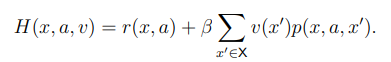

 an
agent observes a state x in finite set X and responds with action a from Γ(x), a subset
of finite set A. The state then updates to x
0 next period with probability p(x, a, x0
).
The objective is to choose a policy σ : X → A such that, when {a'} is selected according
to at = σ(x') at each t, the objective E
P
t>0
β
t
r(x'
, a') is maximized. Here β ∈ (0, 1)
is a discount factor and r is a real-valued reward function. This fits directly into our
framework if we set V to be all functions from X to R and




##**11. When would SARSA likely do better than Q-learning?**

In practice the last point can make a big difference if mistakes are costly - e.g. you are training a robot not in simulation, but in the real world. You may prefer a more conservative learning algorithm that avoids high risk, if there was real time and money at stake if the robot was damaged.

If your goal is to train an optimal agent in simulation, or in a low-cost and fast-iterating environment, then Q-learning is a good choice, due to the first point (learning optimal policy directly). If your agent learns online, and you care about rewards gained whilst learning, then SARSA may be a better choice.



##**12. How does SARSA differ from Q-learning?**

SARSA is on-policy while Q-learning is off-policy.

SARSA will approach convergence allowing for possible penalties from exploratory moves, whilst Q-learning will ignore them. That makes SARSA more conservative - if there is risk of a large negative reward close to the optimal path, Q-learning will tend to trigger that reward whilst exploring, whilst SARSA will tend to avoid a dangerous optimal path and only slowly learn to use it when the exploration parameters are reduced. The classic toy problem that demonstrates this effect is called cliff walking.

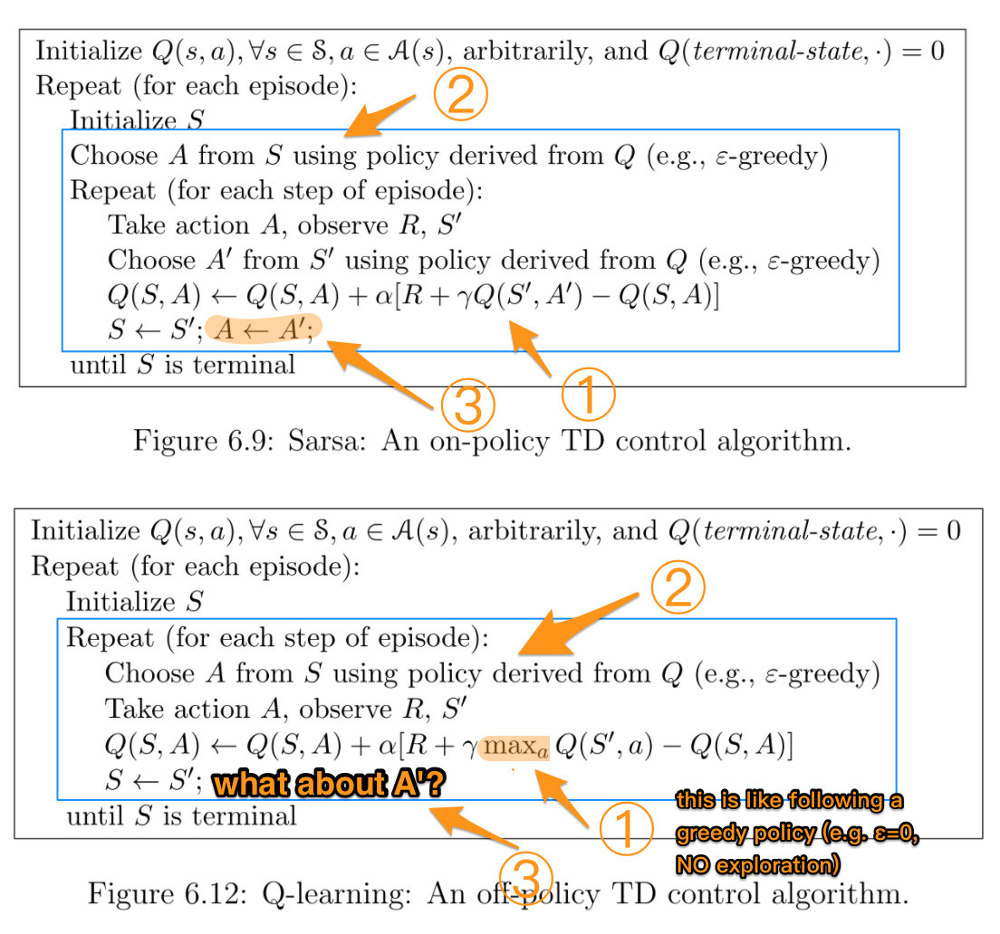

|             | SARSA | Q-learning |
|:-----------:|:-----:|:----------:|
| Choosing A' |   π   |      π     |
| Updating Q  |   π   |      μ     |

where π is a ε-greedy policy (e.g. ε > 0 with exploration), and μ is a greedy policy (e.g. ε == 0, NO exploration).

Given that Q-learning is using different policies for choosing next action A' and updating Q. In other words, it is trying to evaluate π while following another policy μ, so it's an off-policy algorithm.

In contrast, SARSA uses π all the time, hence it is an on-policy algorithm.

More detailed explanation:

The most important difference between the two is how Q is updated after each action. SARSA uses the Q' following a ε-greedy policy exactly, as A' is drawn from it. In contrast, Q-learning uses the maximum Q' over all possible actions for the next step. This makes it look like following a greedy policy with ε=0, i.e. NO exploration in this part.

However, when actually taking an action, Q-learning still uses the action taken from a ε-greedy policy. This is why "Choose A ..." is inside the repeat loop.

Following the loop logic in Q-learning, A' is still from the ε-greedy policy.



##**13. Explain the Q-learning algorithm.**


Q-learning is a model-free, value-based, off-policy learning algorithm.


> Model-free: The algorithm that estimates its optimal policy without the need for any transition or reward functions from the environment.


> Value-based: Q learning updates its value functions based on equations, (say Bellman equation) rather than estimating the value function with a greedy policy.


> Off-policy: The function learns from its own actions and doesn’t depend on the current policy.

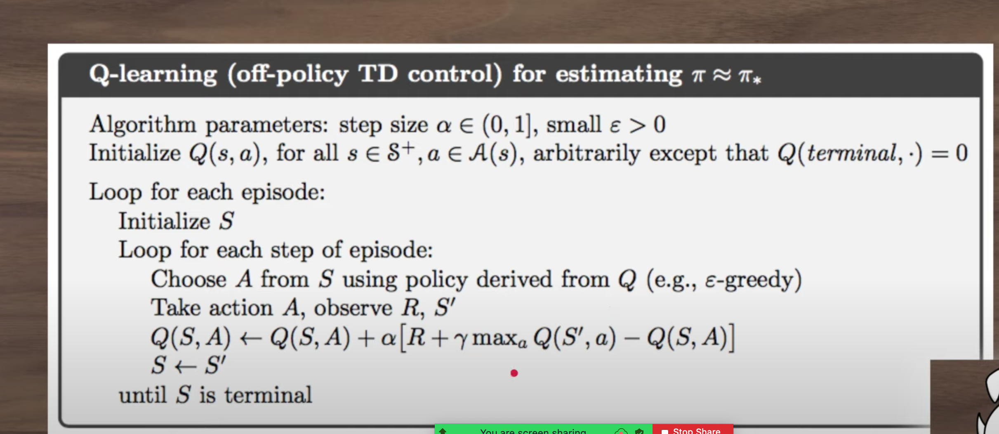

 Q model. The learning process will follow these steps:

1.   Initialize the Q-values table, Q(s, a).
1.   Observe the current state, s.
1.   Choose an action, a, for that state based on one of the action selection from policies like - (-soft, -greedy or softmax).
2.   Take the action, and observe the reward, r, as well as the new state, s'.
2.   Update the Q-value for the state using the observed reward and the maximum reward possible for the next state. The updating is done according to the forumla and parameters described above.
2.   Set the state to the new state, and repeat the process until a terminal state is reached.



##**14. Explain the SARSA algorithm**

From its name, it is clear that it uses state, action, reward, next state, and next action. That is the only difference from Q-Learning, as it replaces the maximization of Q-Learning by expectation over the probability distribution of actions by any exploration policy. So basically, what you have to add is you have to consider one more step to get the next action.


> On policy - On-Policy learning algorithms are the algorithms that evaluate and improve the same policy which is being used to select actions. That means we will try to evaluate and improve the same policy that the agent is already using for action selection. In short , [Target Policy == Behavior Policy].







The Sarsa algorithm is an On-Policy algorithm for TD-Learning. The major difference between it and Q-Learning, is that the maximum reward for the next state is not necessarily used for updating the Q-values. Instead, a new action, and therefore reward, is selected using the same policy that determined the original action. The name Sarsa actually comes from the fact that the updates are done using the quintuple Q(s, a, r, s', a'). Where: s, a are the original state and action, r is the reward observed in the following state and s', a' are the new state-action pair. The procedural form of Sarsa algorithm is comparable to that of Q-Learning:

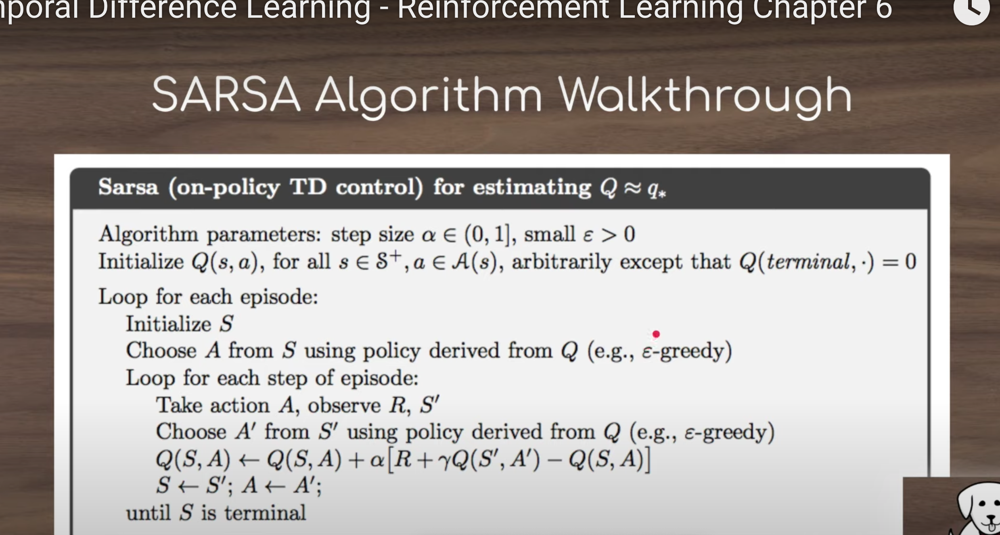

 SARSA model. The learning process will follow these steps:

1.   Initialize the Q-values table, Q(s, a).
1.   Observe the current state, s.
1.   Choose an action, a, for that state based on one of the action selection from policies like - (-soft, -greedy or softmax).
2.   Take the action, and observe the reward, r, as well as the new state, s'.
2.   Update the Q-value for the state using the same policy used above to choose action like - (-soft, -greedy or softmax). The updating is done according to the forumla and parameters.
2.   Set the state to the new state, and repeat the process until a terminal state is reached.

Baseline model in adapted from following github link. Tuning, comments and explaination is provided by me.

https://github.com/jorditorresBCN/Deep-Reinforcement-Learning-Explained/blob/master/DRL_15_16_17_DQN_Pong.ipynb